Image aerialdrone.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\aerialdrone_NormalDocument.jpg


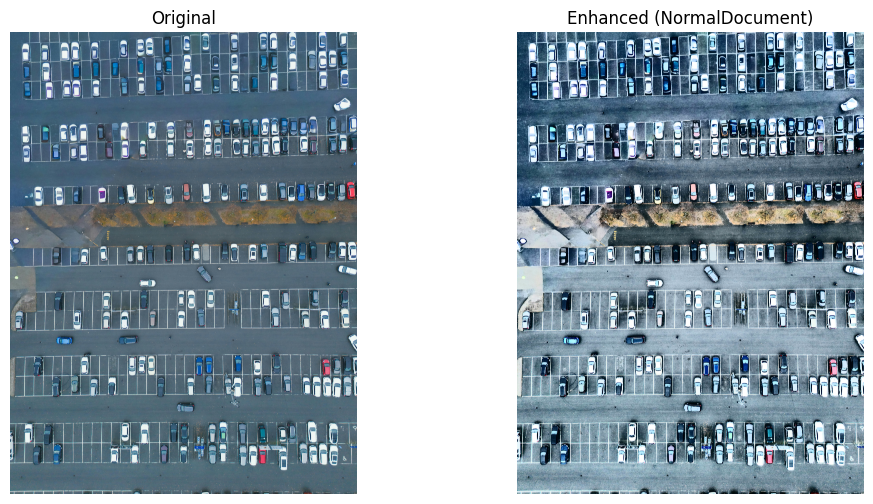

Image artificiallighting.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\artificiallighting_NormalDocument.jpg


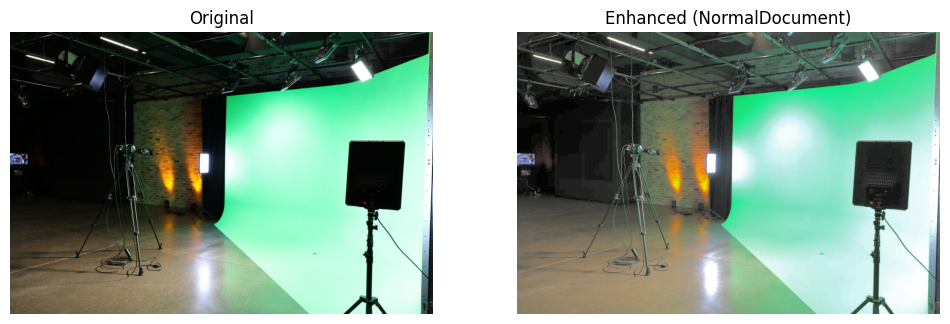

Image backlitgeneral.jpg categorized as Underexposed
Saved enhanced image: enhanced_output\backlitgeneral_Underexposed.jpg


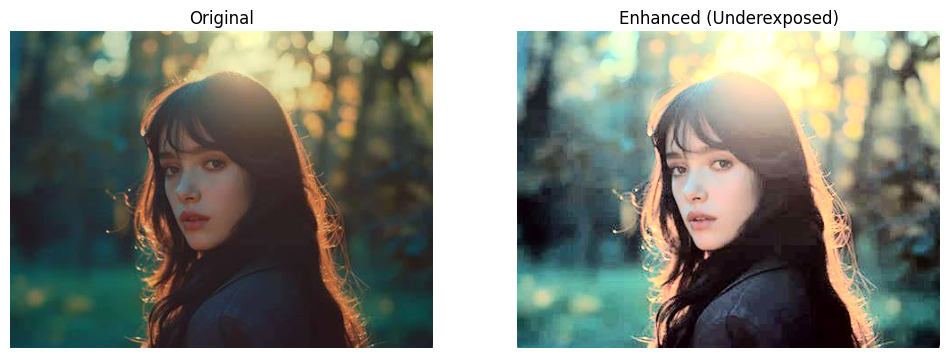

Image backlithuman.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\backlithuman_NormalDocument.jpg


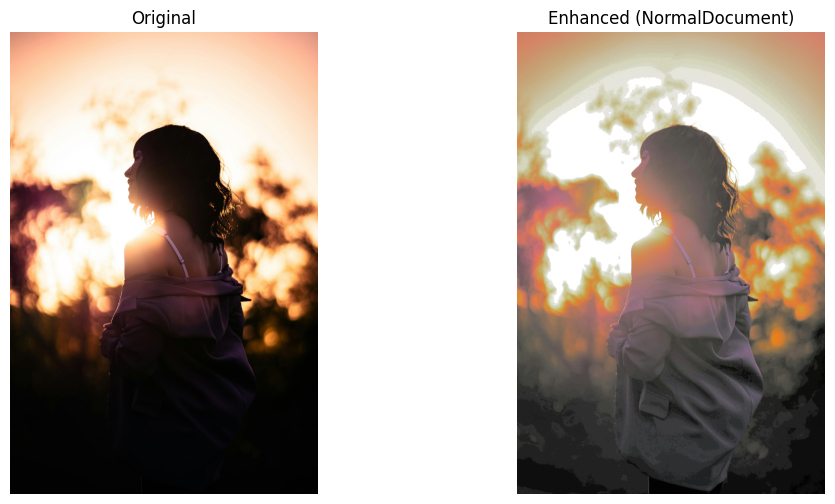

Image beachwater.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\beachwater_NormalDocument.jpg


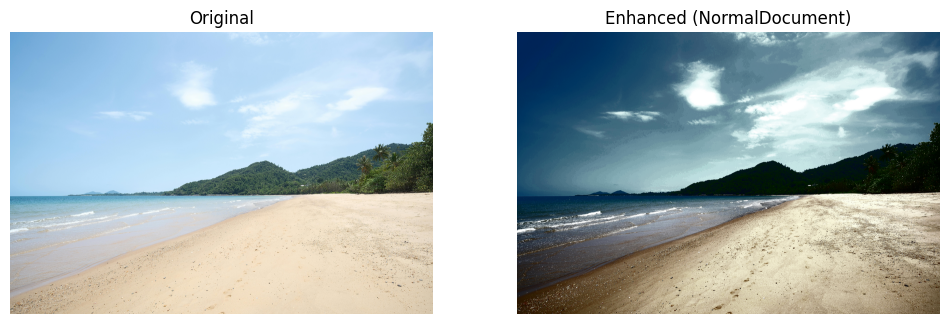

Image coloureddocument.png categorized as NormalDocument
Saved enhanced image: enhanced_output\coloureddocument_NormalDocument.png


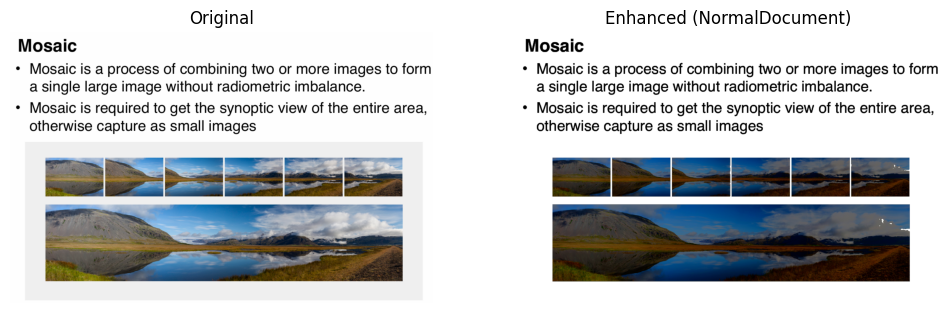

Image curveddocument.png categorized as NormalDocument
Saved enhanced image: enhanced_output\curveddocument_NormalDocument.png


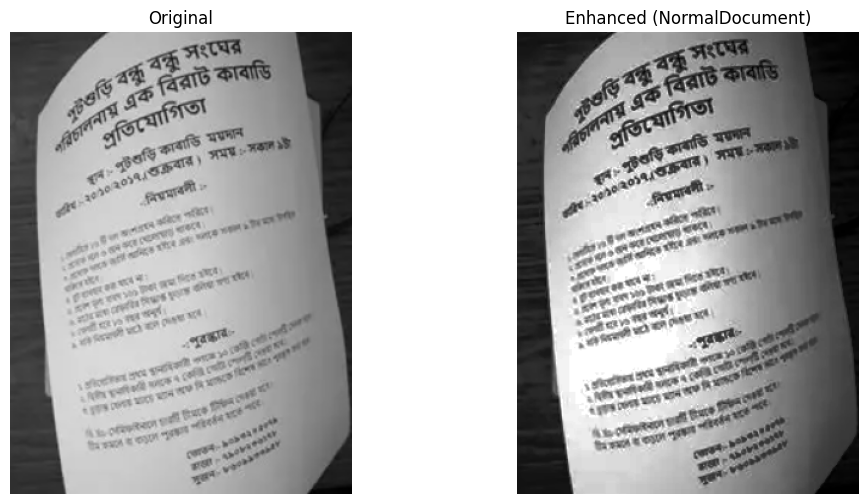

Image document.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\document_NormalDocument.jpg


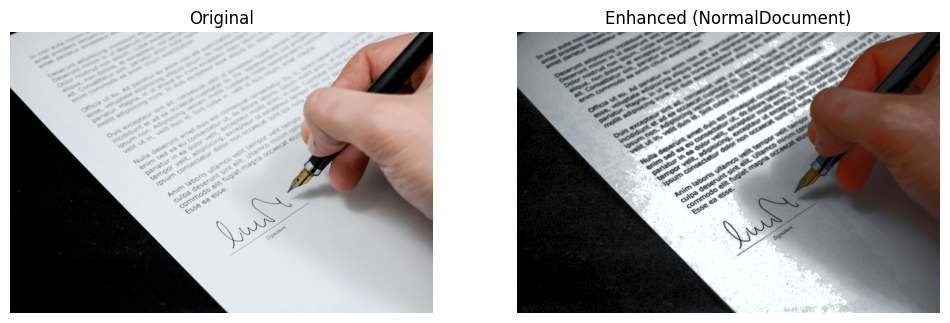

Image extremebacklit.jpg categorized as NightDocument
Saved enhanced image: enhanced_output\extremebacklit_NightDocument.jpg


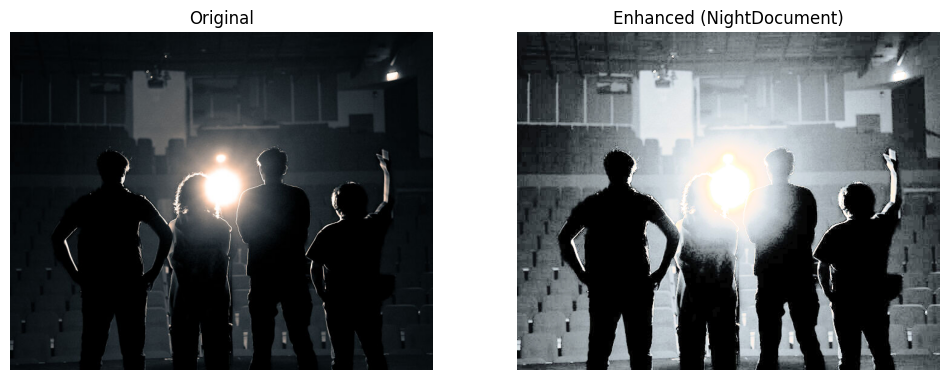

Image fadeddocument.png categorized as NormalDocument
Saved enhanced image: enhanced_output\fadeddocument_NormalDocument.png


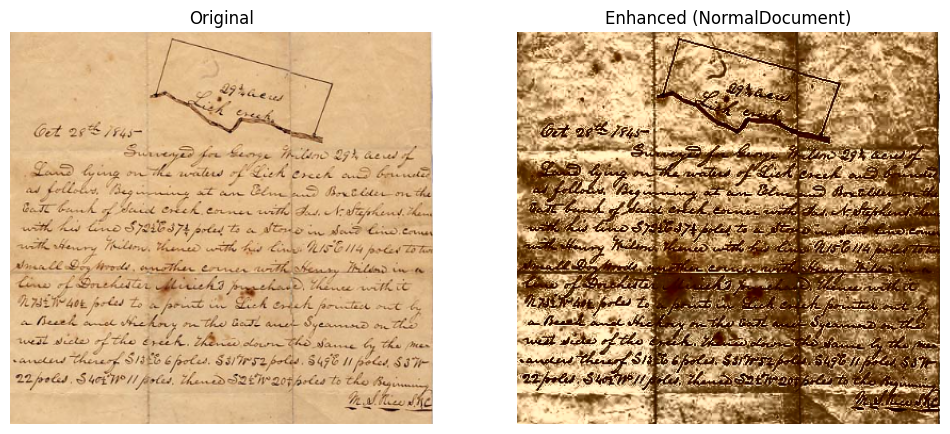

Image filmnegative.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\filmnegative_NormalDocument.jpg


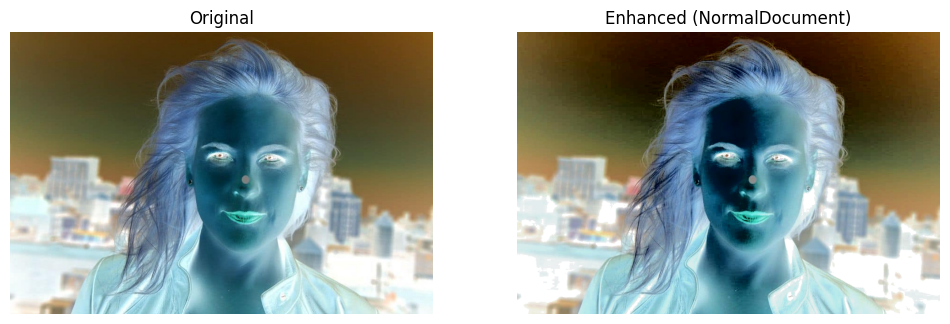

Image food.jpg categorized as NightDocument
Saved enhanced image: enhanced_output\food_NightDocument.jpg


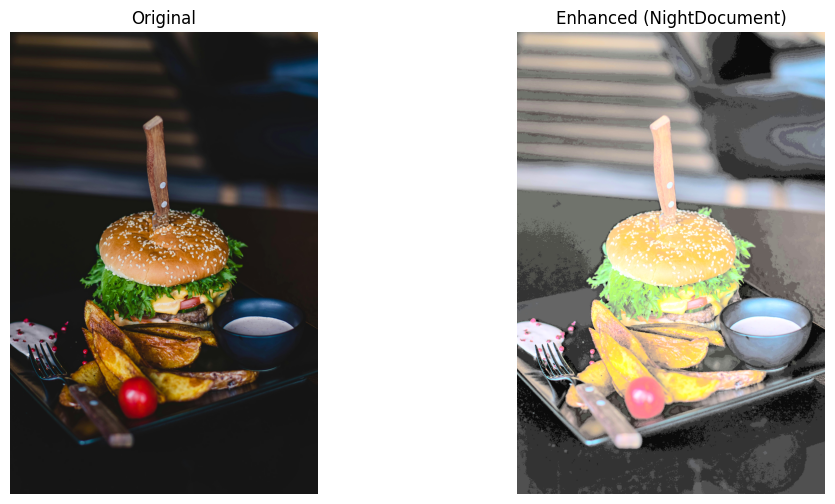

Image glossydocument.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\glossydocument_NormalDocument.jpg


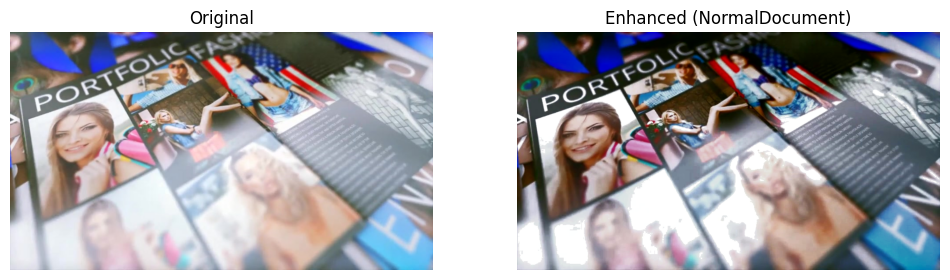

Image groupportrait.jpg categorized as NightDocument
Saved enhanced image: enhanced_output\groupportrait_NightDocument.jpg


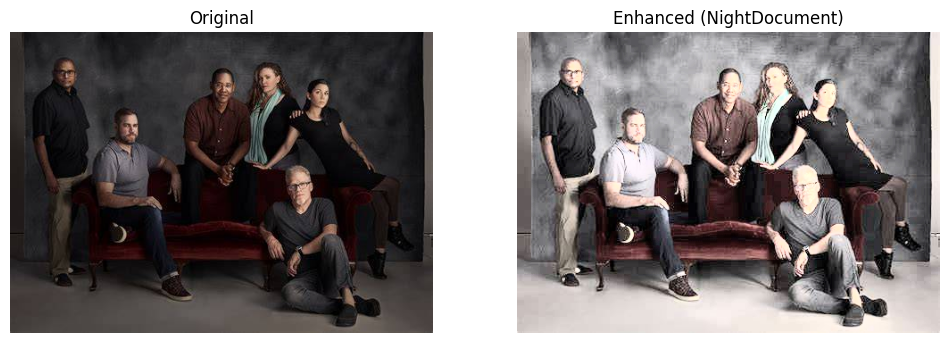

Image handwrittendocument.png categorized as NormalDocument
Saved enhanced image: enhanced_output\handwrittendocument_NormalDocument.png


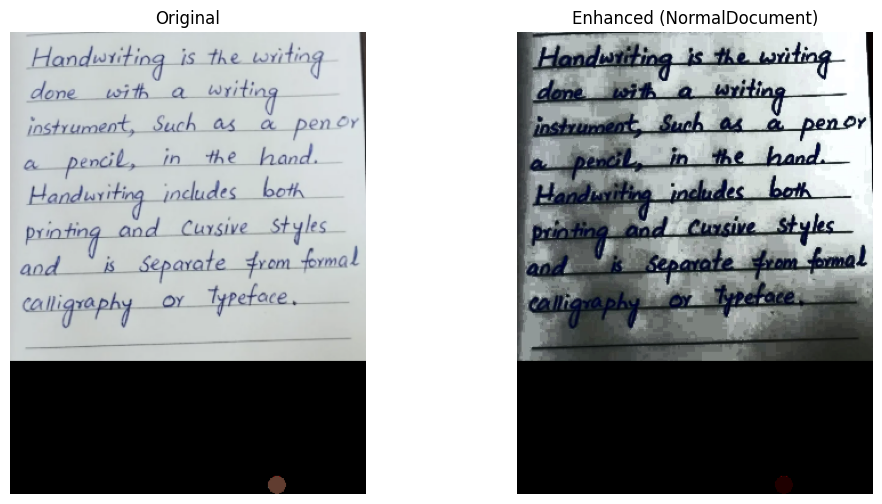

Image HDR.jpg categorized as Underexposed
Saved enhanced image: enhanced_output\HDR_Underexposed.jpg


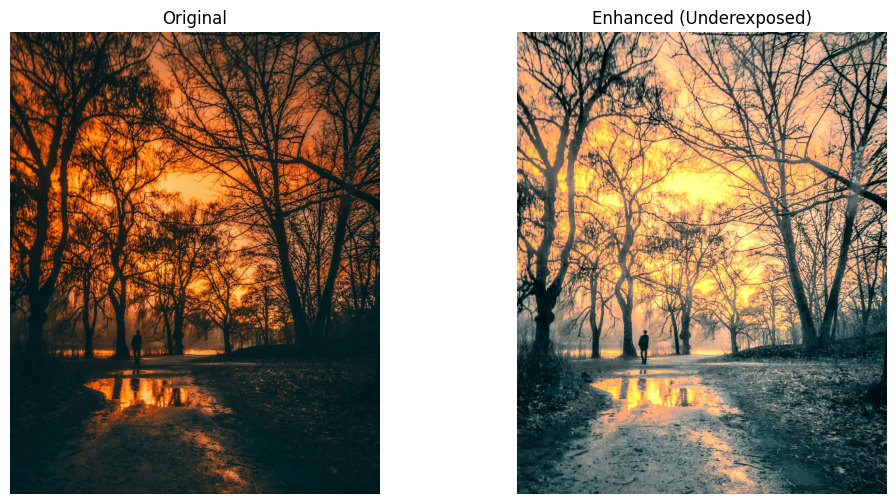

Image indoor.jpg categorized as NightDocument
Saved enhanced image: enhanced_output\indoor_NightDocument.jpg


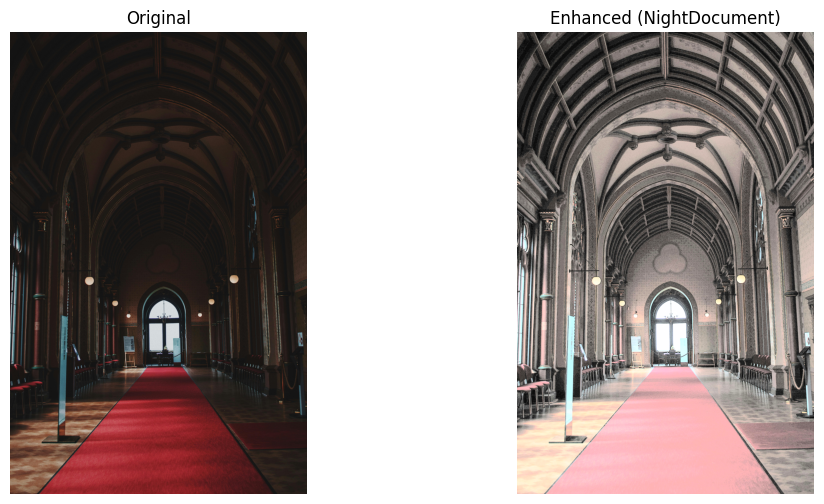

Image infraredthermal.jpg categorized as Underexposed
Saved enhanced image: enhanced_output\infraredthermal_Underexposed.jpg


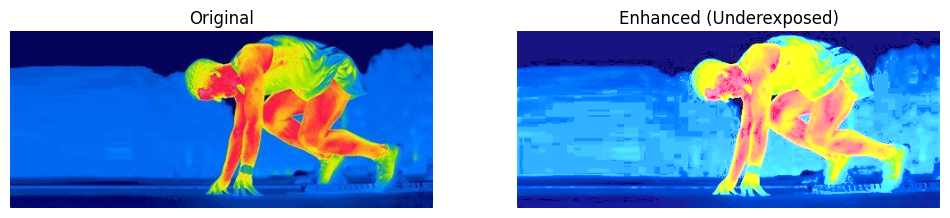

Image landscape.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\landscape_NormalDocument.jpg


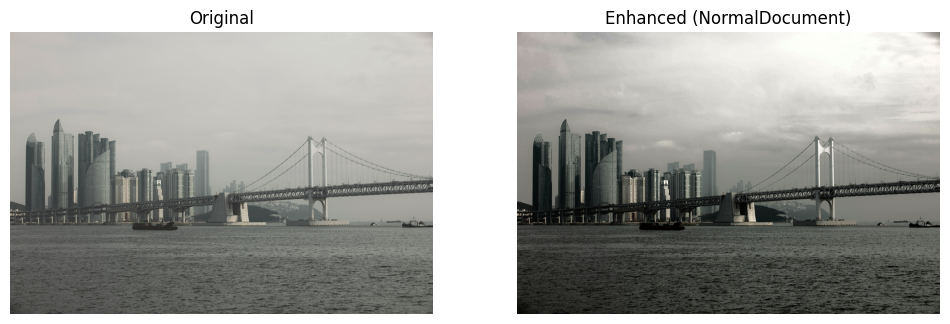

Image lowcontrastdocument.png categorized as NormalDocument
Saved enhanced image: enhanced_output\lowcontrastdocument_NormalDocument.png


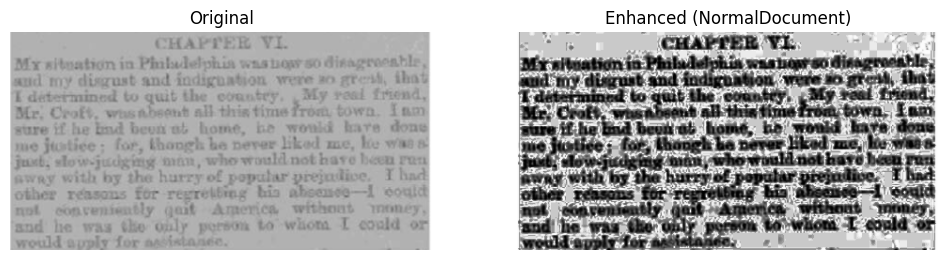

Image lowcontrastjpg.jpg categorized as Underexposed
Saved enhanced image: enhanced_output\lowcontrastjpg_Underexposed.jpg


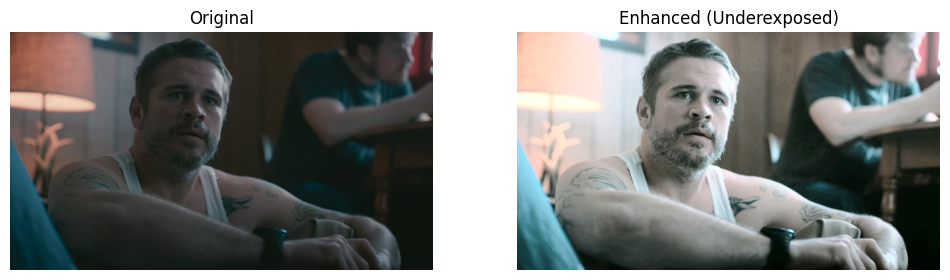

Image lowlightdoc.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\lowlightdoc_NormalDocument.jpg


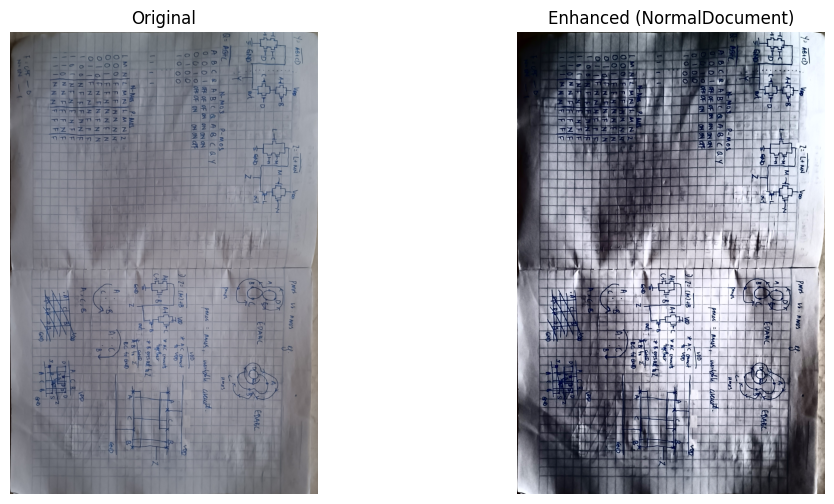

Image macro.jpg categorized as Underexposed
Saved enhanced image: enhanced_output\macro_Underexposed.jpg


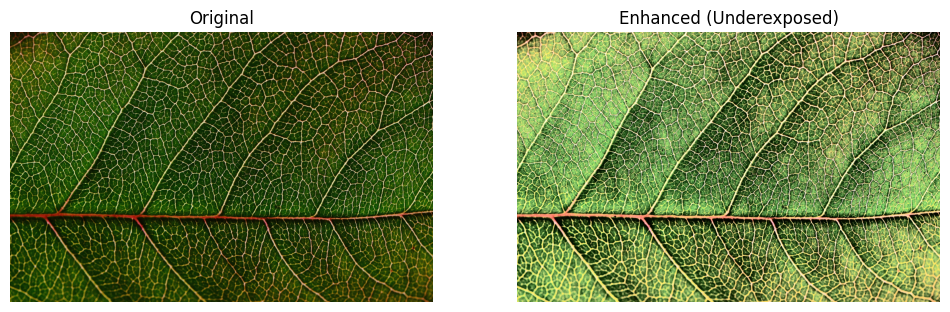

Image monochrome.jpg categorized as Underexposed
Saved enhanced image: enhanced_output\monochrome_Underexposed.jpg


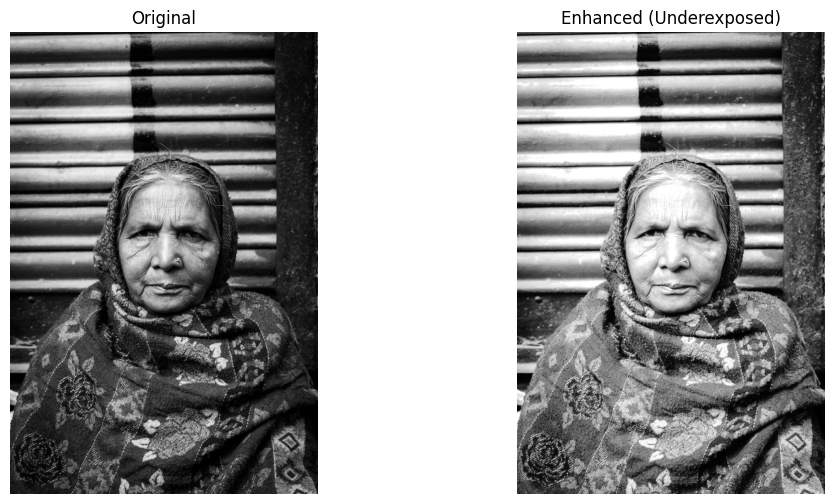

Image motionblurgeneral.jpg categorized as Underexposed
Saved enhanced image: enhanced_output\motionblurgeneral_Underexposed.jpg


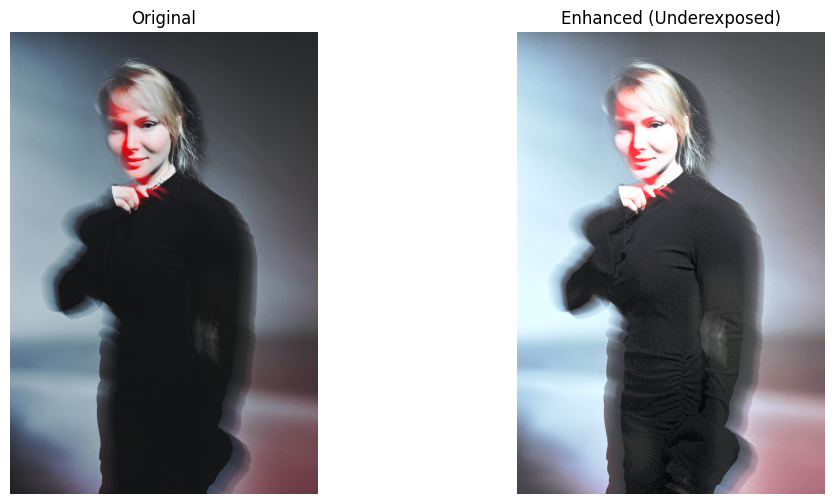

Image motionblurportrait.jpg categorized as Underexposed
Saved enhanced image: enhanced_output\motionblurportrait_Underexposed.jpg


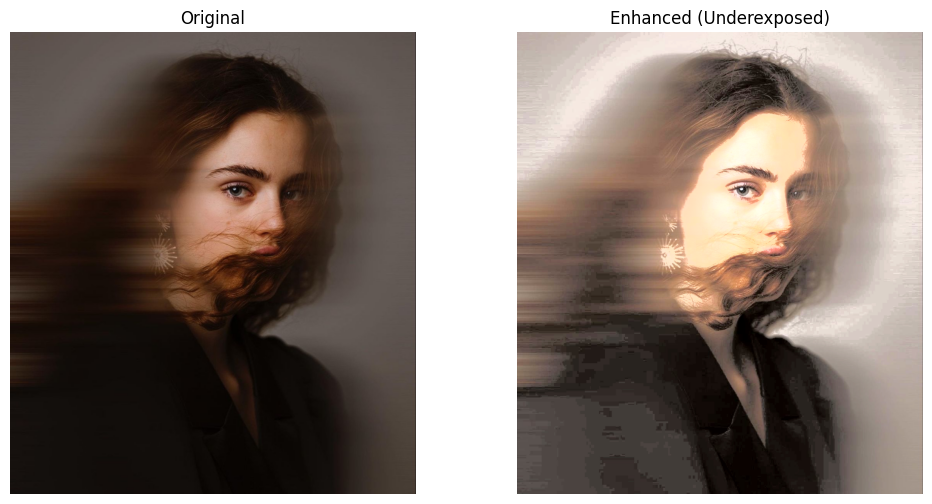

Image multipagescanneddocument.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\multipagescanneddocument_NormalDocument.jpg


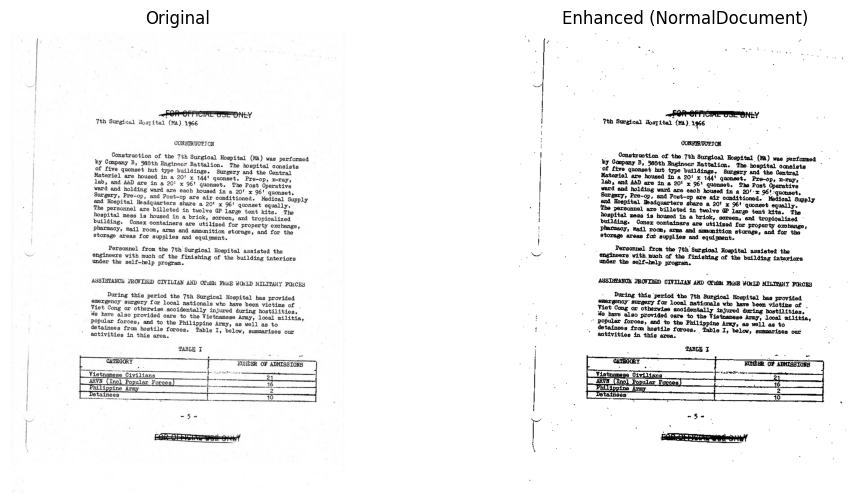

Image nightgeneral.jpg categorized as NightDocument
Saved enhanced image: enhanced_output\nightgeneral_NightDocument.jpg


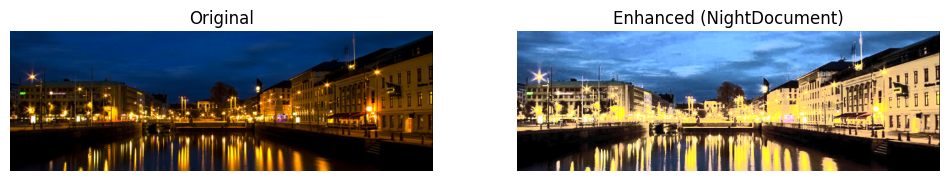

Image nighthuman.jpeg categorized as NightDocument
Saved enhanced image: enhanced_output\nighthuman_NightDocument.jpeg


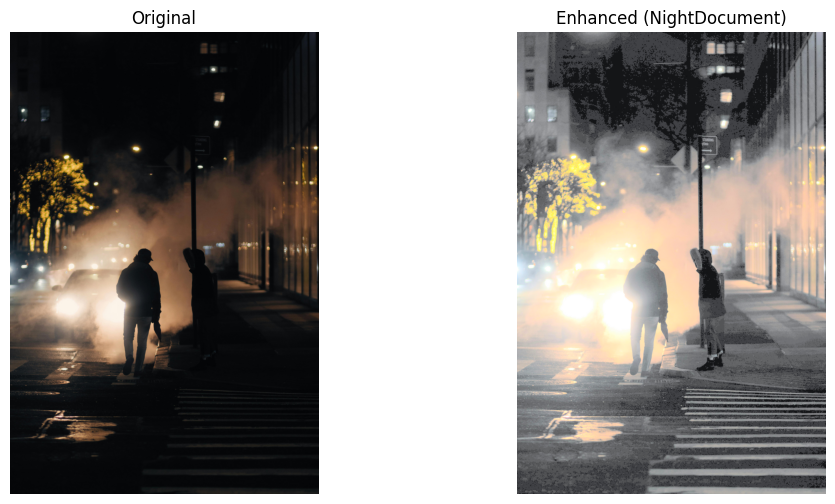

Image nightlandscape.jpg categorized as Underexposed
Saved enhanced image: enhanced_output\nightlandscape_Underexposed.jpg


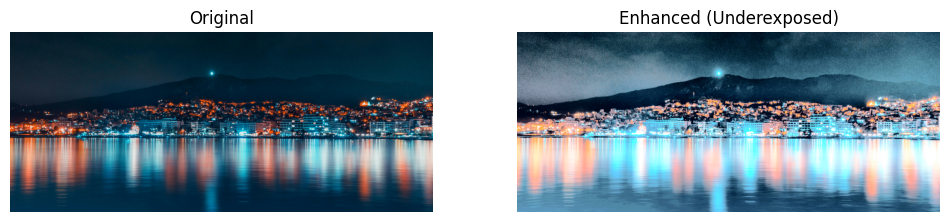

Image normalgeneral.jpg categorized as Underexposed
Saved enhanced image: enhanced_output\normalgeneral_Underexposed.jpg


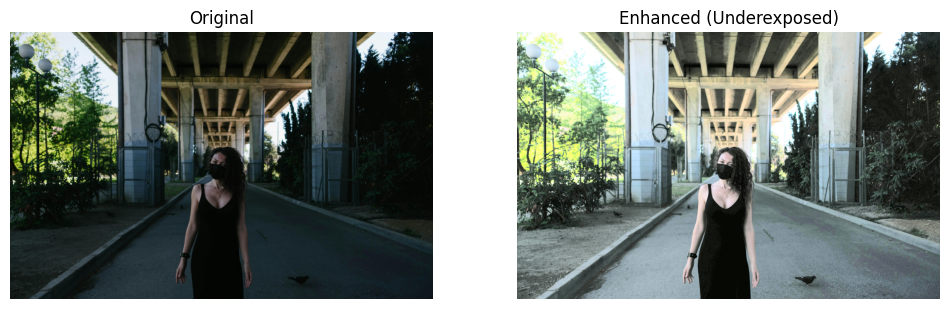

Image normalhuman.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\normalhuman_NormalDocument.jpg


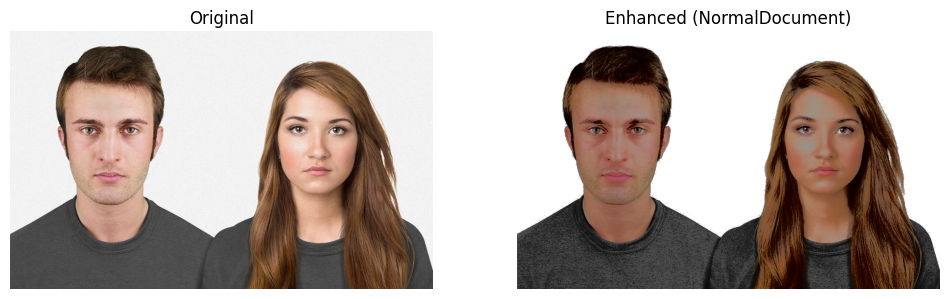

Image sepia.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\sepia_NormalDocument.jpg


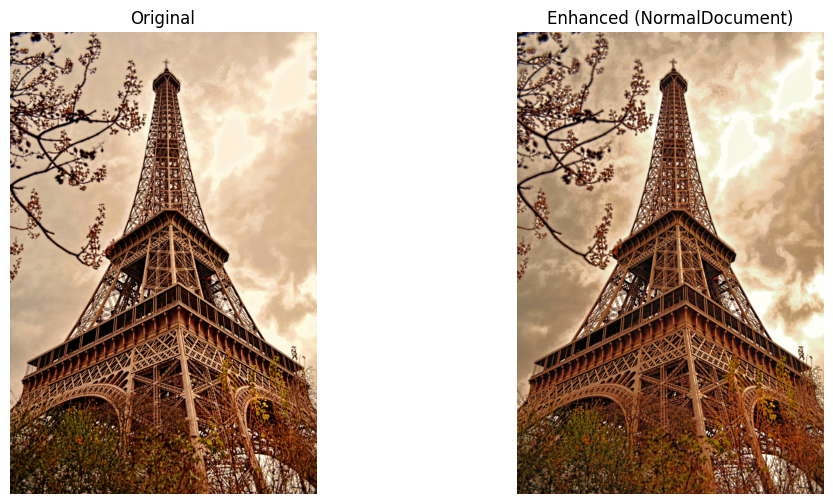

Image shadoweddocument.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\shadoweddocument_NormalDocument.jpg


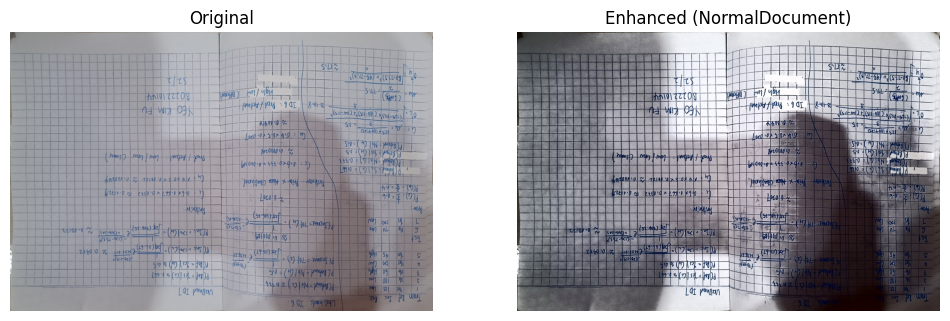

Image skintonesensitive.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\skintonesensitive_NormalDocument.jpg


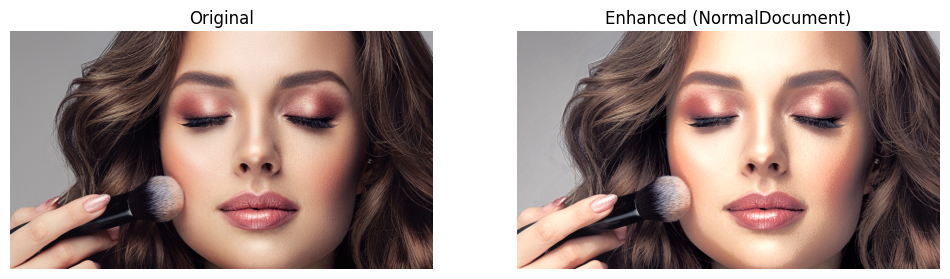

Image snowfog.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\snowfog_NormalDocument.jpg


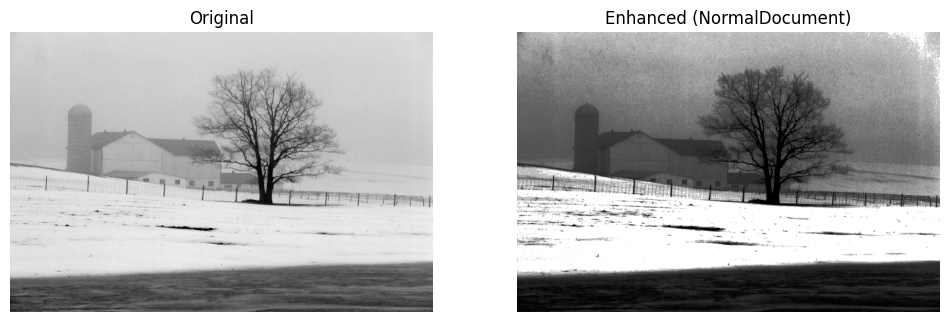

Image Studioportrait.jpg categorized as NightDocument
Saved enhanced image: enhanced_output\Studioportrait_NightDocument.jpg


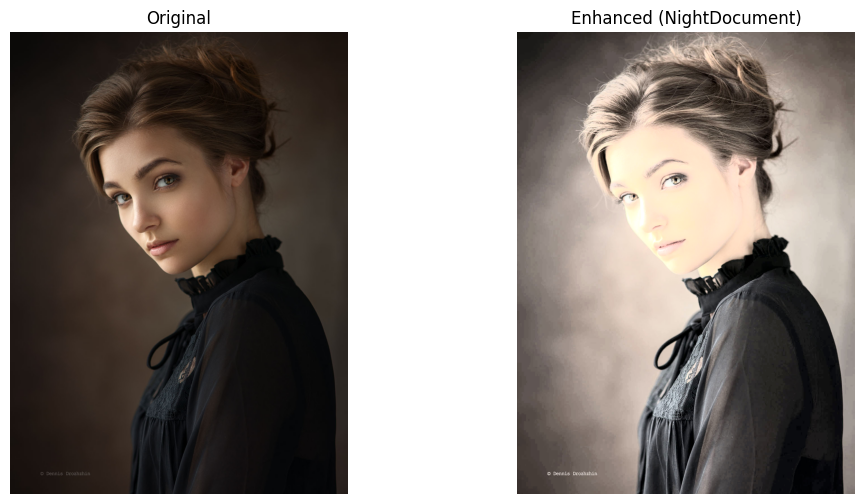

Image sunsetsunrise.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\sunsetsunrise_NormalDocument.jpg


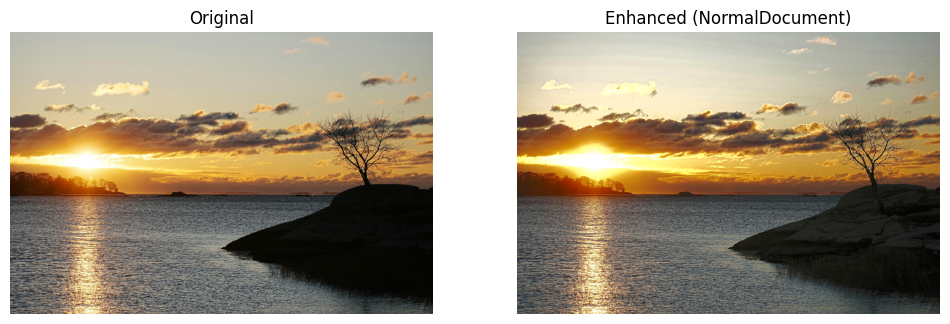

Image urbancityscape.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\urbancityscape_NormalDocument.jpg


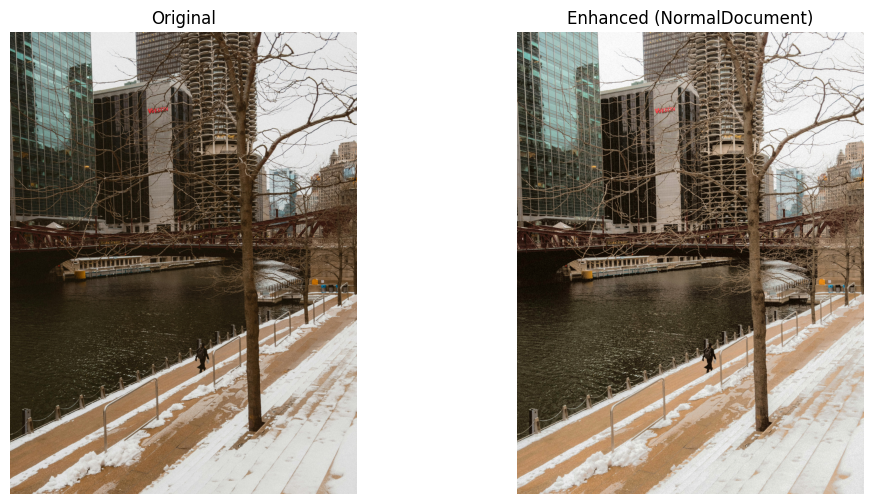

Image warpeddocument.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\warpeddocument_NormalDocument.jpg


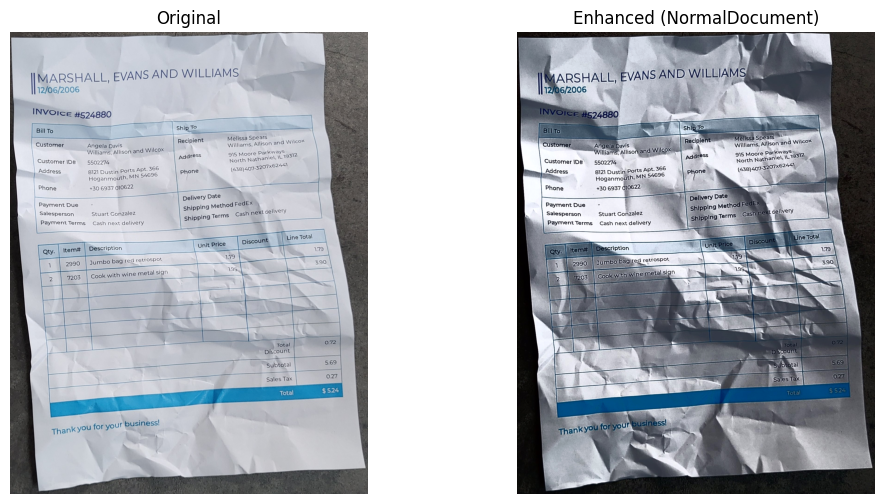

Image washedout.jpg categorized as NormalDocument
Saved enhanced image: enhanced_output\washedout_NormalDocument.jpg


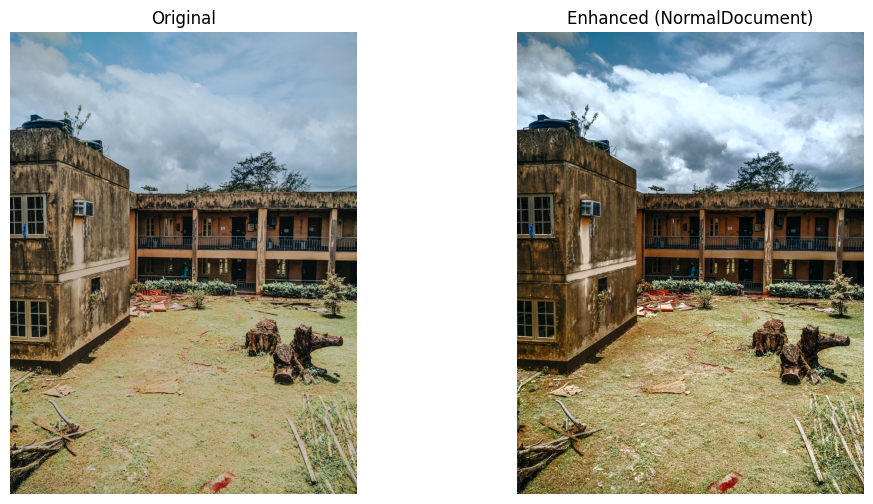

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import json
import os

# --------------------------
# Load Presets
# --------------------------
with open("categorization_presets.json", "r") as f:
    categorization_presets = json.load(f)

with open("enhancement_presets.json", "r") as f:
    enhancement_presets = json.load(f)

# --------------------------
# Helper Functions
# --------------------------

def contrast_stretch(image, alpha=1.0):
    img_float = image.astype(np.float32)
    min_val, max_val = np.min(img_float), np.max(img_float)
    stretched = ((img_float - min_val) / (max_val - min_val)) * 255
    stretched = stretched * alpha
    return np.clip(stretched, 0, 255).astype(np.uint8)

def apply_histogram_modification(image, method="equalization", clip_limit=0.02, channel="luminance"):
    if len(image.shape) == 3 and channel == "luminance":
        ycrcb = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
        y = ycrcb[:,:,0]
        if method == "equalization":
            y_eq = cv2.equalizeHist(y)
        elif method == "local_equalization":
            clahe = cv2.createCLAHE(clipLimit=clip_limit*100, tileGridSize=(8,8))
            y_eq = clahe.apply(y)
        ycrcb[:,:,0] = y_eq
        return cv2.cvtColor(ycrcb, cv2.COLOR_YCrCb2BGR)
    elif len(image.shape) == 2 or channel == "grayscale":
        if method == "equalization":
            return cv2.equalizeHist(image)
        elif method == "local_equalization":
            clahe = cv2.createCLAHE(clipLimit=clip_limit*100, tileGridSize=(8,8))
            return clahe.apply(image)
    else:
        # Apply per channel
        b,g,r = cv2.split(image)
        b = cv2.equalizeHist(b)
        g = cv2.equalizeHist(g)
        r = cv2.equalizeHist(r)
        return cv2.merge([b,g,r])

# --------------------------
# Preset Lookup
# --------------------------

def get_enhancement_preset(preset_name, enhancement_presets):
    for category_presets in enhancement_presets.values():
        if preset_name in category_presets:
            return category_presets[preset_name]
    return None

# --------------------------
# Categorization (Simple Example)
# --------------------------
def categorize_image(image_path):
    """
    Simple rule-based categorization using average brightness.
    More sophisticated logic can replace this.
    Returns a preset name from categorization_presets.
    """
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    mean_val = np.mean(gray)
    
    # Example rules (replace with your actual categorization logic)
    if mean_val < 50:
        return "NightDocument"
    elif mean_val < 100:
        return "Underexposed"
    else:
        return "NormalDocument"

# --------------------------
# Enhancement Function
# --------------------------
def enhance_image(image_path, preset_name, output_folder="enhanced_output"):
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error loading {image_path}")
        return
    
    preset = get_enhancement_preset(preset_name, enhancement_presets)
    if preset is None:
        print(f"Preset '{preset_name}' not found in enhancement presets.")
        return
    
    # Apply contrast stretching
    alpha = preset.get("contrast_stretch", {}).get("alpha", 1.0)
    img_cs = contrast_stretch(image, alpha)
    
    # Apply histogram modification
    hist_method = preset.get("histogram_modification", {}).get("method", "equalization")
    clip_limit = preset.get("histogram_modification", {}).get("clip_limit", 0.02)
    channel = preset.get("histogram_modification", {}).get("channel", "luminance")
    img_final = apply_histogram_modification(img_cs, method=hist_method, clip_limit=clip_limit, channel=channel)
    
    # Save output
    os.makedirs(output_folder, exist_ok=True)
    base_name = os.path.basename(image_path)
    name, ext = os.path.splitext(base_name)
    output_path = os.path.join(output_folder, f"{name}_{preset_name}{ext}")
    cv2.imwrite(output_path, img_final)
    print(f"Saved enhanced image: {output_path}")
    
    # Show comparison
    plt.figure(figsize=(12,6))
    plt.subplot(1,2,1)
    plt.title("Original")
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    
    plt.subplot(1,2,2)
    plt.title(f"Enhanced ({preset_name})")
    plt.imshow(cv2.cvtColor(img_final, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.show()

# --------------------------
# Main Pipeline
# --------------------------
if __name__ == "__main__":
    input_folder = "input_images"
    for fname in os.listdir(input_folder):
        if fname.lower().endswith((".jpg",".png",".jpeg")):
            path = os.path.join(input_folder, fname)
            # Step 1: Categorize
            preset_name = categorize_image(path)
            print(f"Image {fname} categorized as {preset_name}")
            # Step 2: Enhance
            enhance_image(path, preset_name)
